In [1]:
import numpy as np
import pandas as pd

In [2]:
datX=np.load('x_train.npy')
datY=np.log(np.load('y_train.npy'))
datX=pd.DataFrame(datX, columns=datX.dtype.names)
datX

,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long
0,2014-09-16,5.0,3.25,3710,34200,2.0,False,3,8,2510,1200,1986,0,98074,47.610100,-122.046997
1,2014-11-18,3.0,1.75,2820,8879,1.0,False,5,7,1540,1280,1920,1957,98146,47.509399,-122.375999
2,2014-11-10,3.0,1.00,1240,239144,1.0,False,3,6,1240,0,1921,1992,98038,47.430302,-122.045998
3,2015-04-16,4.0,2.50,2670,8279,2.0,False,3,7,2670,0,1999,0,98148,47.429199,-122.328003
4,2014-07-23,3.0,2.25,2700,4025,2.0,False,4,8,1760,940,1907,0,98122,47.607399,-122.293999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,2014-05-21,4.0,2.75,2290,6120,2.0,False,4,7,2170,120,1926,0,98115,47.674599,-122.327003
14996,2015-04-01,3.0,2.00,1430,9250,1.0,False,4,8,990,440,1983,0,98052,47.695202,-122.096001
14997,2014-07-11,2.0,1.00,640,7768,1.0,False,3,6,640,0,1942,0,98106,47.514999,-122.359001
14998,2014-05-15,3.0,1.00,1630,10304,1.0,False,5,7,1630,0,1953,0,98155,47.754799,-122.317001


In [3]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

%matplotlib inline

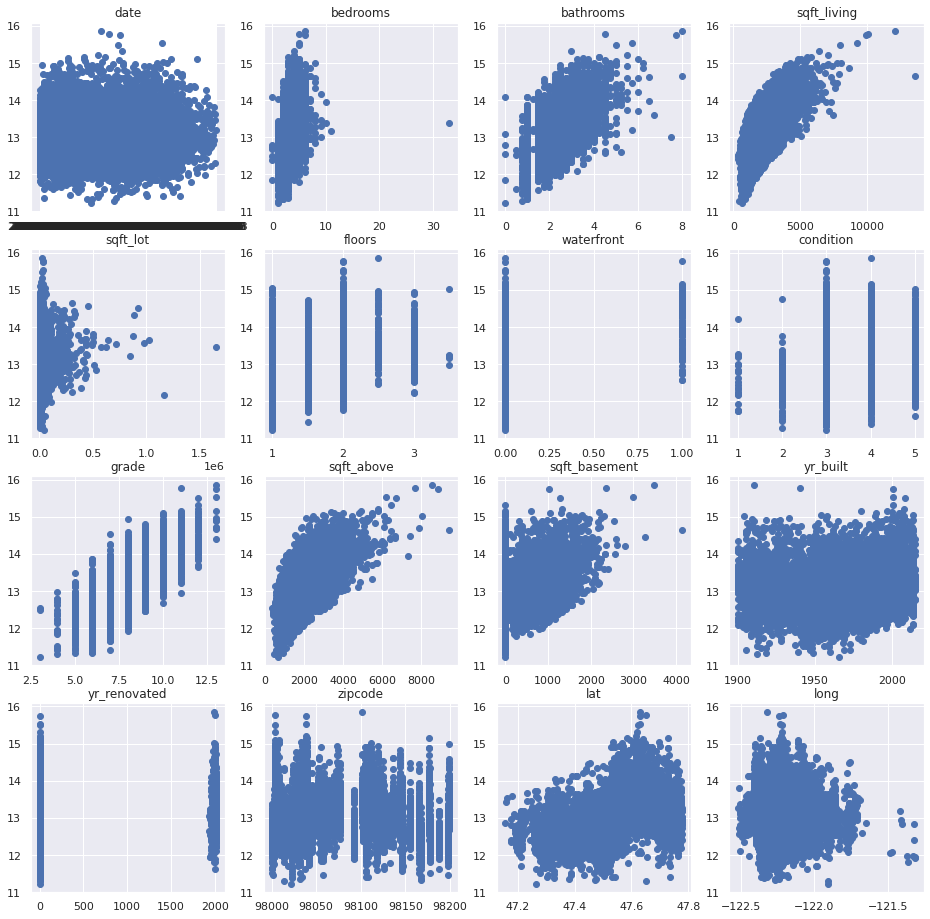

In [4]:
f, ax=plt.subplots(4, 4, figsize=(16,16))

for i, name in enumerate(datX.columns):
    ax[i//4][i%4].scatter(datX[name], datY)
    ax[i//4][i%4].set_title(name)

In [5]:
#your code goes here
X= datX[["bedrooms", "bathrooms","sqft_living","floors","condition","grade","sqft_above","sqft_basement","long","lat"]].values
N=X.shape[0]
m=X.shape[1]

In [6]:
def loss(w, X, y):
    #your code goes here
    b = np.ones(shape=(N,1))
    X = np.concatenate([b,X], axis=1)
    y_hat = X.dot(w)
    diff = y-y_hat
    lossValue = (1/N)*np.sum((diff)**2)
    return lossValue

Q3) Computer analticaly the gradient of the $ Loss(\vec{w}) $

$ \frac{\partial Loss}{\partial w_{i}} $ or $ \nabla Loss $

$$ Loss = \frac{1}{N} \sum_{i=1}^{N} (y_{i} - \hat{y_{i}})(x_{i}) $$ do it

$$ \frac{\partial Loss}{\partial w_{i}} = \frac{-2}{N} \sum_{i=1}^{N} (y_{i} - \hat{y_{i}})(x_{i}) $$



In [61]:
def grad(w_k, X, y):
    #your code goes here
    b = np.ones(shape=(N,1))
    X = np.concatenate([b,X], axis=1)
    y_hat = X.dot(w_k)
    diff = y-y_hat
    lossGradient = (-2/N)*X.T.dot(diff)
    lossGradient = lossGradient / np.linalg.norm(lossGradient)
    return lossGradient

In [62]:
def gradDescent(w_init, alpha, X, y, maxiter=500, eps=1e-2):
    losses=[]
    weights=[w_init]
    
    curiter=0
    w_k=weights[-1]
    
    #your code goes here
    while curiter < maxiter and (np.linalg.norm(grad(w_k,X,y))>eps):
        w_k=w_k-(alpha*grad(w_k, X, y))
        lossValue_k=loss(w_k, X, y)
        print(f'iter: {curiter}, loss= {lossValue_k}')

        weights.append(w_k.T)
        losses.append(lossValue_k)
        
        curiter += 1
        
    return weights, losses

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
iter: 0, loss= 163.32473899891414
iter: 1, loss= 156.28023195263967
iter: 2, loss= 149.41872996567466
iter: 3, loss= 142.74023241924223
iter: 4, loss= 136.24473864277098
iter: 5, loss= 129.93224790794417
iter: 6, loss= 123.80275942186833
iter: 7, loss= 117.85627231920063
iter: 8, loss= 112.09278565303835
iter: 9, loss= 106.51229838432906
iter: 10, loss= 101.11480936950377
iter: 11, loss= 95.90031734596228
iter: 12, loss= 90.86882091494736
iter: 13, loss= 86.02031852122279
iter: 14, loss= 81.35480842881101
iter: 15, loss= 76.87228869183711
iter: 16, loss= 72.57275711924385
iter: 17, loss= 68.45621123176393
iter: 18, loss= 64.52264820901635
iter: 19, loss= 60.772064823875084
iter: 20, loss= 57.20445736024934
iter: 21, loss= 53.81982150897468
iter: 22, loss= 50.61815223442741
iter: 23, loss= 47.59944360139196
iter: 24, loss= 44.763688547064895
iter: 25, loss= 42.11087857591796
iter: 26, loss= 39.64100334382298
iter: 27, loss= 37.35405007943327
iter: 28, 

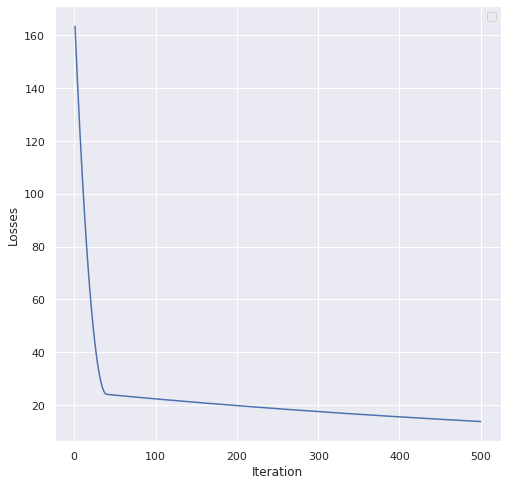

In [66]:
plt.figure(figsize=(8,8))

#your code goes here
w_init=np.zeros((m+1,))
print(w_init)
alpha=1e-4
maxiter=500
eps=1e-2
y = datY
weights, losses = gradDescent(w_init, alpha, X, y, maxiter, eps)
plt.plot(range(1,maxiter+1),losses)
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.legend()

In [74]:
### your code goes here
select_size = 8
selected_i = np.random.choice(len(X), size=select_size, replace=False)
select_w = weights[-1]
select_X = X[selected_i]
b = np.ones(shape=(select_size,1))
select_X = np.concatenate([b,select_X], axis=1)
y_hat = select_X.dot(select_w)
print(y_hat)
print(y[selected_i])
print(f'difference:{y_hat-y[selected_i]}')

[10.80690136  9.79729279 16.07389462  5.97033285 14.97964561 16.87724144
 11.99692387 10.95620794]
[12.53537639 12.4159283  13.50762578 12.49799571 13.64115717 13.30801272
 14.10743362 13.23032052]
difference:[-1.72847503 -2.61863551  2.56626884 -6.52766286  1.33848844  3.56922871
 -2.11050976 -2.27411257]


### Task 6. Discussion
Answer following questions:

1. Does your method converge at least for some alpha? If not, what might be the workaround?

2. How does changing of the alpha influence the speed of convergence?

3. Are the optimal weights in all convergent cases the same?

4. How does this affect the Loss function?

1. Yes! It does converage but it get stuck at a low loss. I think initializing the weights randomly would solve this problem and allow fast converagnce.

2. I have changed the alpha from 1e-2 to 1e-8 and it seems that as you have smaller alpha, the change decreases and convergance slow down. However, when you have larger alpha (like 0.1) the change happens exeteramly fast and might harm the converagnce of the model.

3. No, they aren't.

4. Initializing the weights with zeros or ones will allow convergance if the alpha is small but isn't that small that it will take more training iterations to reach the minimal loss. However, the most optimal weights are reached when the optimal alpha is used but the weights are initlized randomly.